## Localization Task

We start from the localization task for the Class: Referee

In [1]:
import pandas as pd
from sklearn.model_selection import train_test_split
import tensorflow as tf
import tensorflow.keras as tfk
from tensorflow.keras import layers as tfkl, models as tfkm
#from tensorflow.keras.applications import ResNet50
#from tensorflow.keras.applications.resnet import preprocess_input
#from tensorflow.keras.preprocessing.image import img_to_array
#from tensorflow.keras.applications import imagenet_utils
from imutils.object_detection import non_max_suppression
from matplotlib import pyplot as plt
import numpy as np
import argparse
import imutils
import time
import cv2
import os
import numpy as np
import random
from sklearn.utils import class_weight
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input
from sklearn.metrics import precision_score, accuracy_score, f1_score, recall_score
from sklearn.metrics import precision_recall_curve
from tensorflow.keras.models import load_model
from sklearn.metrics import confusion_matrix


In [2]:
SEED = 42

os.environ['PYTHONHASHSEED'] = str(SEED)
random.seed(SEED)
np.random.seed(SEED)
tf.random.set_seed(SEED)

We have the binary clue labels $\texttt{clues\_df}$ for ball, referee and gate.

In [3]:
clues_df = pd.read_csv('clues.csv', index_col=0)
clues_df.head()

,Gate,Ball,Referee
img_id,,,
1,0,0,0
2,0,0,1
94,0,1,1
95,0,1,1
96,0,1,1


## Weakly Supervised Object Localization (WSOL)

Can be useful to perform localization without training images annotated with bounding boxes.

We exploit the dataset's feature of being annotated for classification, with image pairs $\{X_i, \ell\}$,
- $X_i \in X$ set of images;
- $\ell \in \Lambda$ set of labels.

What we intend to do is:

- Training a classifier for multiplòe object categories (referee, gate, ball)
    - train with image-level labels

- the network ends with:
    - GAP (Global Averaging Pooling) layer on final conv feature map
    - FC layer to output logits

Then: CAM or Grad-CAMs can be computed directly from the weights of the FC layer and the conv feature map to infer the **bounding box location**.

Pro: class-specific saliency technique

## Step 1. GAP + FC + CAM

Each image may contain 0, 1, 2, or 3 clues. Since it could be useful to use an incremental ablation study, i separate the models into one binary classifier per clue. Also, a single image gives always the same activations, but the heatmaps (CAM outputs) may vary based on the weights, which depend on the class.

### Referee

Start training a binary classifier using the labels:
- 1: the referee is visible
- 0: the referee is not

RK) Class Activation Maps are class-specific.
- “where the network looks” to make a decision for a certain class.
- require:
    - Supervised learning
    - A specific class prediction (because the weights from FC layer point to the class-specific regions)



We extract the image ids and the labels:

In [4]:
image_ids = clues_df.index.astype(str).to_numpy()
ref_label = clues_df['Referee'].values

In [6]:
print(f"Nr images: {len(image_ids)}")
print(f"Label Referee Distribution:\n 0\t\t1")
print("----------------------")
print(f"{sum(ref_label.tolist()) / len(image_ids)}\t\t{1- (sum(ref_label.tolist()) / len(image_ids))}")

Nr images: 10000
Label Referee Distribution:
 0		1
----------------------
0.3254		0.6746


not severe imbalance, but still meaningful. The model may become biased toward class 1 ("referee present"), simply because it sees it more often. Given that the goal is localization, and I want to extract CAMs only when the model predicts 1, it is better to **avoid false positives**. (better not to have a bounding box than having a wrong one).

Since one class is appearing approx twice as much as the other, can compute it exactly.

### MobileNetV2
(try for prototyping, faster), lightweight pretrained on ImageNet

**rk** ResNet 18 (better performance, risk that CAM could be not as visible as mobilenet, slower training)

**rk** eventually cnn

In [7]:
# train-test split
train_ids, val_ids, y_train, y_val = train_test_split(
    image_ids, ref_label,
    test_size=0.2,
    stratify=ref_label,
    random_state=SEED
)

#### Loading and Preprocessing

We defining the image loader: (256x256) as accepted input size for the model (must be squared).

In [8]:
target_dim = (256, 256)

def load_images_from_path(image_ids, path="Filtered_Dataset", img_dim=(224, 224)):
    images = []
    for img_id in image_ids:
        img_path = os.path.join(path, f"{img_id}.jpg")
        img = cv2.imread(img_path)
        if img is not None:
            img = cv2.resize(img, img_dim)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            images.append(img)
    return np.array(images, dtype='float32')



def load_images_original(image_ids, path="Filtered_Dataset"):
    images=[]
    for img_id in image_ids:
        img_path = os.path.join(path, f"{img_id}.jpg")
        img_bgr = cv2.imread(img_path)  # BGR, original size
        if img_bgr is not None:
            img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB) # To RGB, still original
            images.append(img_rgb)
    
    original_shape = img_rgb.shape[:2]  # (H, W) (enough one img)
    return np.array(images, dtype='float32'), original_shape

In [9]:
# load raw:
X_train = load_images_from_path(train_ids, img_dim=target_dim)
X_val  = load_images_from_path(val_ids, img_dim=target_dim)

In [10]:
# preprocessing for MobileNetV2
# Rescales input from [-1, 1]
X_train_pre = preprocess_input(X_train)
X_val_pre = preprocess_input(X_val)

Rebalancing classes:

In [11]:
from sklearn.utils import class_weight

weights_array = class_weight.compute_class_weight(
    class_weight='balanced',
    classes=np.unique(y_train),
    y=y_train
)

class_weights = {0: weights_array[0], 1: weights_array[1]}

Model: use defaulting weights of imagenet.

'pooling' = None as default: means that the output of the model will be the 4D tensor output of the last convolutional block.

trainable=False--> Freezes the base model so its weights are **not updated** during training. useful for task-specific model

Loads MobileNetV2 without the classification head.

In [13]:
input_shape = (target_dim[0], target_dim[1], 3)


def mobnetv2_ref(input_shape=input_shape):
    base = tf.keras.applications.MobileNetV2(input_shape=input_shape, include_top=False, weights='imagenet')
    base.trainable = False

    inputs = tfkl.Input(shape=input_shape)
    x = base(inputs)

    # apply GAP --> reduces feature map from (7,7,1280) to (1280,)
    x = tfkl.GlobalAveragePooling2D(name='gap')(x)

    # FC dense layer, single output unit
    # binary classification --> pr(referee in the image)
    output = tfkl.Dense(1, activation='sigmoid', name='MobileNetV2_Ref')(x)

    model = tfkm.Model(inputs=inputs, outputs=output)
    return model

In [14]:
ref_model1 = mobnetv2_ref()

ref_model1.compile(
    optimizer=tf.keras.optimizers.Adam(),
    loss='binary_crossentropy',
    metrics=[
        'accuracy',
        tf.keras.metrics.Precision(name='precision')]
)

history = ref_model1.fit(
                    X_train_pre, y_train,
                    epochs=20,
                    batch_size=32,
                    validation_data=(X_val_pre, y_val),
                    class_weight=class_weights,
                    callbacks=[
                        tf.keras.callbacks.EarlyStopping(patience=5, restore_best_weights=True)
                    ],
                    verbose=1
                )


C:\Users\Utente\AppData\Local\Temp\ipykernel_35156\1842098600.py:5: UserWarning: `input_shape` is undefined or non-square, or `rows` is not in [96, 128, 160, 192, 224]. Weights for input shape (224, 224) will be loaded as the default.
  base = tf.keras.applications.MobileNetV2(input_shape=input_shape, include_top=False, weights='imagenet')


Epoch 1/20
250/250 ━━━━━━━━━━━━━━━━━━━━ 382s 1s/step - accuracy: 0.7016 - loss: 0.5653 - precision: 0.5399 - val_accuracy: 0.7970 - val_loss: 0.4550 - val_precision: 0.6533
Epoch 2/20
250/250 ━━━━━━━━━━━━━━━━━━━━ 193s 758ms/step - accuracy: 0.7926 - loss: 0.4579 - precision: 0.6470 - val_accuracy: 0.8155 - val_loss: 0.4298 - val_precision: 0.6780
Epoch 3/20
250/250 ━━━━━━━━━━━━━━━━━━━━ 168s 671ms/step - accuracy: 0.8028 - loss: 0.4298 - precision: 0.6602 - val_accuracy: 0.8235 - val_loss: 0.4175 - val_precision: 0.6901
Epoch 4/20
250/250 ━━━━━━━━━━━━━━━━━━━━ 165s 661ms/step - accuracy: 0.8146 - loss: 0.4128 - precision: 0.6746 - val_accuracy: 0.8265 - val_loss: 0.4099 - val_precision: 0.6934
Epoch 5/20
250/250 ━━━━━━━━━━━━━━━━━━━━ 169s 675ms/step - accuracy: 0.8178 - loss: 0.4006 - precision: 0.6778 - val_accuracy: 0.8300 - val_loss: 0.4048 - val_precision: 0.6991
Epoch 6/20
250/250 ━━━━━━━━━━━━━━━━━━━━ 177s 708ms/step - accuracy: 0.8226 - loss: 0.3909 - precision: 0.6843 - val_accurac

In [17]:
def plot_training_history(history):
    plt.figure(figsize=(12, 4))

    # Accuracy
    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'], label='train_acc')
    plt.plot(history.history['val_accuracy'], label='val_acc')
    plt.plot(history.history['precision'], label='train_precision')
    plt.plot(history.history['val_precision'], label='val_precision')
    plt.title('Accuracy and Precision over epochs')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()

    # Loss
    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'], label='train_loss')
    plt.plot(history.history['val_loss'], label='val_loss')
    plt.title('Loss over epochs')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()

    plt.tight_layout()
    plt.show()


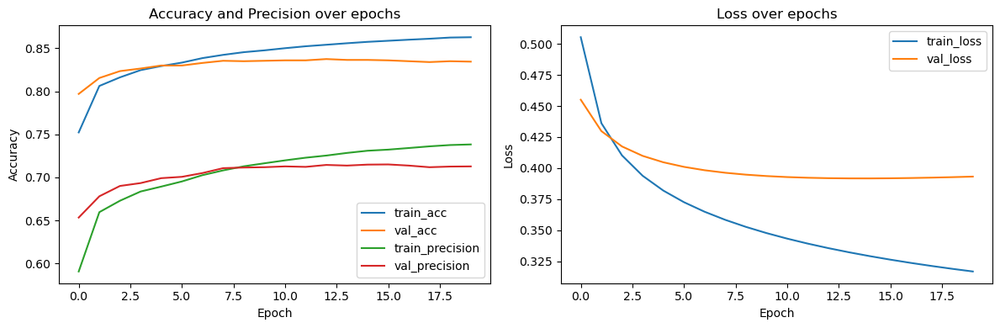

In [16]:
plot_training_history(history)

We observe a logarithmic increase in train accuracy - precision. In val set accuracy stagnates soon, precision keeps increasing at a minimum rate. Train loss keeps decreasing, val loss decreases until epoch $\sim$ 14, then flattens. No clear loss divergence, just a mild stall.

tune sensitivity: can apply a decision threshold to reduce false positives

In [18]:
y_probs = ref_model1.predict(X_val_pre, batch_size=32)

63/63 ━━━━━━━━━━━━━━━━━━━━ 35s 531ms/step


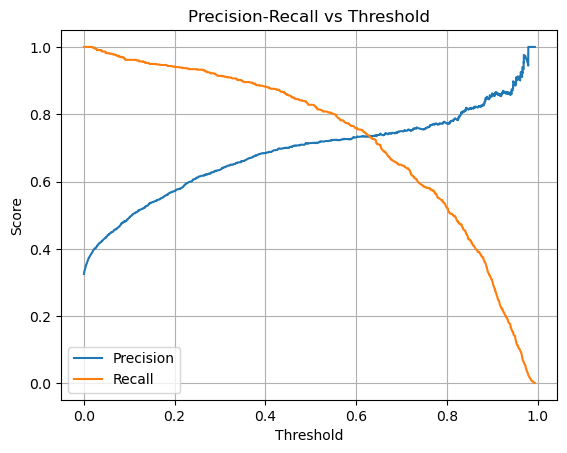

In [19]:
precisions, recalls, thresholds = precision_recall_curve(y_val, y_probs)

plt.plot(thresholds, precisions[:-1], label='Precision')
plt.plot(thresholds, recalls[:-1], label='Recall')
plt.xlabel('Threshold')
plt.ylabel('Score')
plt.title('Precision-Recall vs Threshold')
plt.legend()
plt.grid(True)
plt.show()

Save model

In [ ]:
ref_model1.save("Referee_CAM_Model.h5")

In [21]:
ref_model1.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 256, 256, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mobilenetv2_1.00_224            │ (None, 8, 8, 1280)     │     2,257,984 │
│ (Functional)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ gap (GlobalAveragePooling2D)    │ (None, 1280)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ MobileNetV2_Ref (Dense)         │ (None, 1)              │         1,281 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,261,829 (8.63 MB)

 Trainable params: 1,281 (5.00 KB)

 Non-trainable params: 2,257,984 (8.61 MB)

 Optimizer params: 2,564 (10.02 KB)

## Generate Cam

In [20]:
from PIL import Image

CAM = $\sum_k w_k f_k(x)$,
- $w_k$: weights from dense layer
- $f_k(x)$: activation maps from final conv layer

CAMs represent the areas of maximum 'attention' in the image. Therefore, as the model is trained on a binary classification task, I expect the focus to be high near the area where the object is located.

Cams will be used as a proxy to extract the bounding boxes needed for the analysis.

In [22]:
def generate_cam(model, img_id, req_dim=target_dim, class_index=0, return_original=False):

    """
    Generates a CAM for a given image ID.
    Returns the resized CAM (to match resized image),
    and optionally the original image and shape.

    Input: model, img_id:int, return_original (defaults to False)
    Output: return_original=False --> cam resized to (256, 256), img_pre (np.array)
            return_original=True --> cam x target, img_pre, cam x original, img_orig
    """

    # Load and preprocess resized image (for model input)
    img_raw = load_images_from_path([img_id], img_dim=req_dim)[0]
    img_pre = preprocess_input(img_raw.astype(np.float32))  # shape: (256, 256, [-1,1]^3)

    # Load original image (if required)
    if return_original:
        img_orig, orig_shape = load_images_original([img_id])
        img_orig = img_orig[0]  # unwrap batch
        h_orig, w_orig = orig_shape

    # Get conv features from model
    base_model = model.get_layer("mobilenetv2_1.00_224")
    conv_layer = base_model.get_layer("Conv_1")
    conv_model = tf.keras.Model(inputs=base_model.input, outputs=conv_layer.output)

    image_batch = np.expand_dims(img_pre, axis=0)
    conv_output = conv_model(image_batch)[0].numpy()  

    # weighted sum
    weights = model.get_layer("MobileNetV2_Ref").get_weights()[0][:, class_index]
    cam = np.dot(conv_output, weights)
    cam = np.maximum(cam, 0)
    cam = (cam - cam.min()) / (cam.max() - cam.min() + 1e-8)

    cam_resized = cv2.resize(cam, req_dim)

    if return_original:
        # Resize to original img dim
        cam_resized_original = cv2.resize(cam, (w_orig, h_orig))
        return cam_resized, img_pre, cam_resized_original, img_orig
    else:
        return cam_resized, img_pre

In [23]:
def overlay_cam_on_image(image_array, cam, alpha=0.5, cmap='jet', title="CAM Overlay"):
    """
    Overlays a CAM heatmap on the given RGB image.

    Args:
        image: np.ndarray, RGB image of shape (H, W, 3), original or resized
        cam: np.ndarray, heatmap of shape (H, W), same as image
        alpha: blending factor
        cmap: color map (currently unused since we use cv2 COLORMAP_JET)
        title: plot title
    """
    assert image_array.shape[:2] == cam.shape, f"CAM shape {cam.shape} and image shape {image_array.shape[:2]} must match."

    # Convert CAM to heatmap
    heatmap = cv2.applyColorMap(np.uint8(255 * cam), cv2.COLORMAP_JET)  # BGR
    heatmap = cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB)  # to RGB

    # Blend heatmap and image
    overlay = cv2.addWeighted(image_array.astype(np.uint8), 1 - alpha, heatmap, alpha, 0)

    # Show
    plt.imshow(overlay)
    plt.axis("off")
    plt.title(title)
    plt.show()

#### 1. Compare CAMs for Label=1 and Label=0 Images:
- is it worth taking the bounding box of *all* images?
    no, just the positive-labeled
- all the ones with label=1?
- the ones that satisfy some threshold? 

##### 1.a Label=1

In [24]:
folder = "Filtered_Dataset/"
clues_df[clues_df['Referee'] == 1].sample(10).index

Index([89385, 10661, 5740, 51883, 41616, 45160, 45595, 65082, 6731, 61137], dtype='int64', name='img_id')

In [ ]:
#tried_1 = [83471, 5740]

Example 1

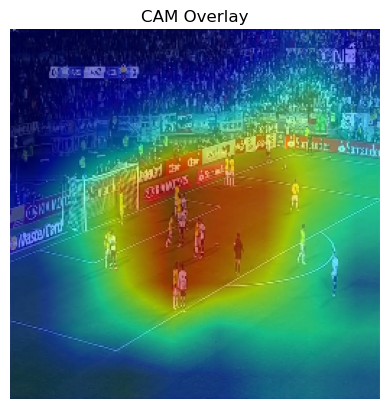

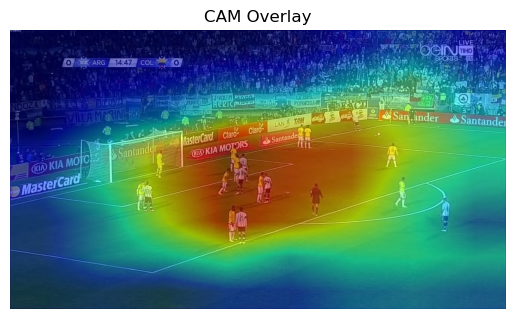

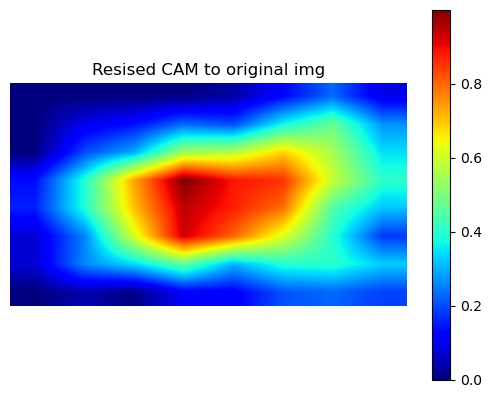

In [ ]:
cam_resized, img_pre, cam_resized_original, img_orig = generate_cam(ref_model1,
                                                                    img_id=6731,
                                                                    req_dim=target_dim,
                                                                    return_original=True)
img_raw = load_images_from_path(image_ids=[6731], img_dim=target_dim)[0]
overlay_cam_on_image(image_array= img_raw.astype(np.uint8), cam=cam_resized)
overlay_cam_on_image(image_array = img_orig, cam=cam_resized_original)

plt.imshow(cam_resized_original, cmap='jet')
plt.colorbar()
plt.title("Resised CAM to original img")
plt.axis("off")
plt.show()

Example 2:

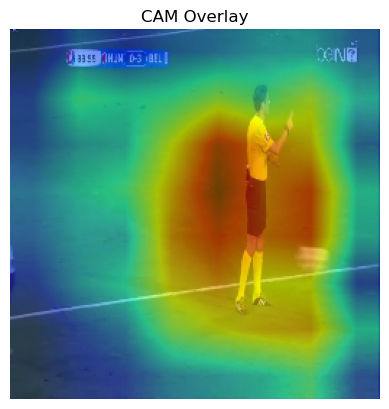

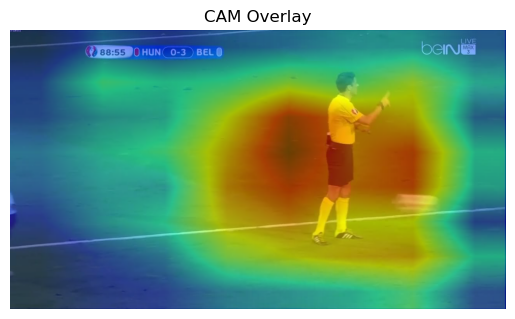

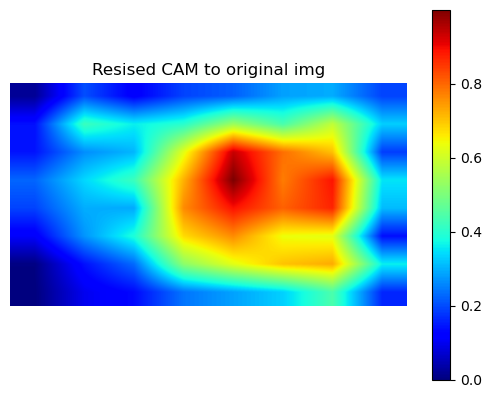

In [29]:
cam_resized, img_pre, cam_resized_original, img_orig = generate_cam(ref_model1,
                                                                    img_id=5740,
                                                                    req_dim=target_dim,
                                                                    return_original=True)
img_raw = load_images_from_path(image_ids=[5740], img_dim=target_dim)[0]
overlay_cam_on_image(image_array= img_raw.astype(np.uint8), cam=cam_resized)
overlay_cam_on_image(image_array = img_orig, cam=cam_resized_original)

plt.imshow(cam_resized_original, cmap='jet')
plt.colorbar()
plt.title("Resised CAM to original img")
plt.axis("off")
plt.show()

##### 1.b Label=0

In [34]:
clues_df[clues_df['Referee']==0].sample(5).index

Index([29934, 95387, 56895, 5430, 62029], dtype='int64', name='img_id')

In [372]:
tried_0 = [82871, 59525, 15007]

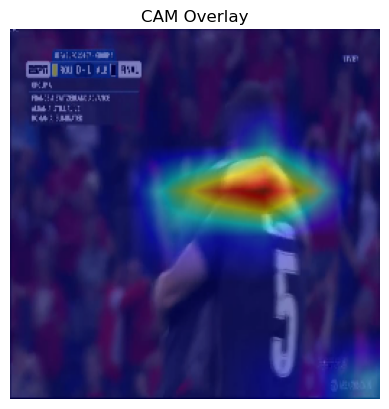

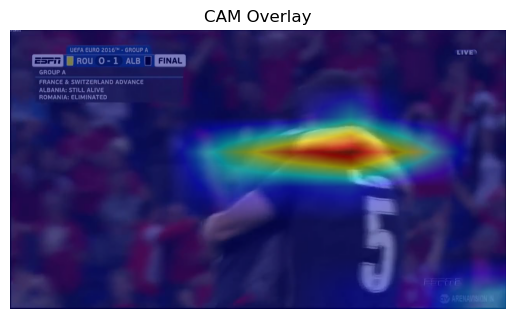

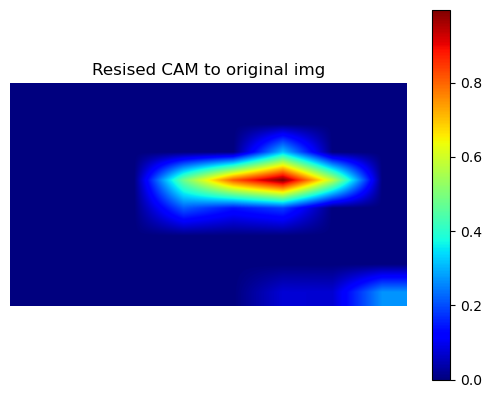

In [32]:
cam_resized, img_pre, cam_resized_original, img_orig = generate_cam(ref_model1,
                                                                    img_id=15007,
                                                                    req_dim=target_dim,
                                                                    return_original=True)
img_raw = load_images_from_path(image_ids=[15007], img_dim=target_dim)[0]
overlay_cam_on_image(image_array= img_raw.astype(np.uint8), cam=cam_resized)
overlay_cam_on_image(image_array = img_orig, cam=cam_resized_original)
plt.imshow(cam_resized_original, cmap='jet')
plt.colorbar()
plt.title("Resised CAM to original img")
plt.axis("off")
plt.show()


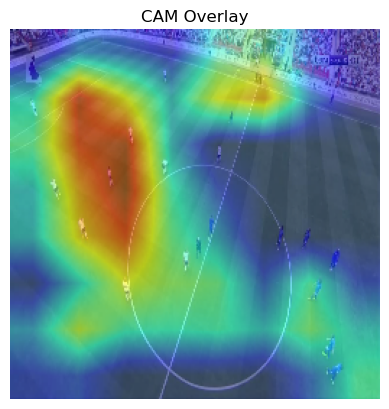

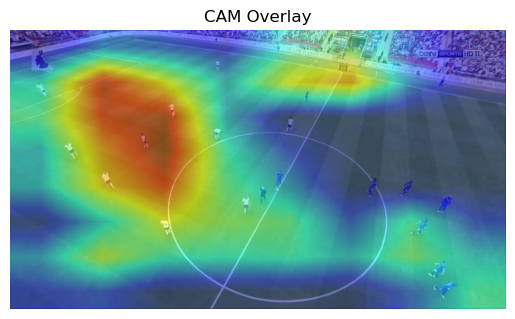

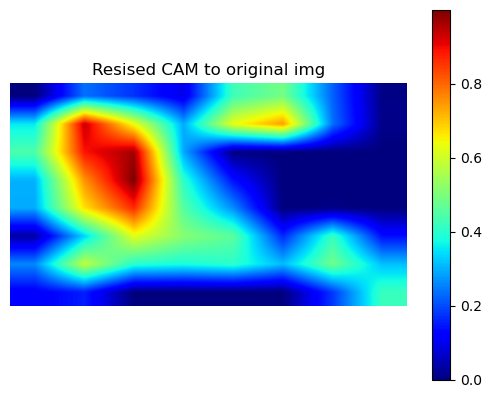

In [35]:
cam_resized, img_pre, cam_resized_original, img_orig = generate_cam(ref_model1,
                                                                    img_id=62029,
                                                                    req_dim=target_dim,
                                                                    return_original=True)
img_raw = load_images_from_path(image_ids=[62029], img_dim=target_dim)[0]
overlay_cam_on_image(image_array= img_raw.astype(np.uint8), cam=cam_resized)
overlay_cam_on_image(image_array = img_orig, cam=cam_resized_original)
plt.imshow(cam_resized_original, cmap='jet')
plt.colorbar()
plt.title("Resised CAM to original img")
plt.axis("off")
plt.show()


Considerations: it is more appropriate to remove the images labeled as 0 (in which the referee is not visible), since the bounding boxes that can ne generated would be misleading for the downstream task.

It is also noticeable that, even when the referee is visible in the image, the CAMs are not extremely refined at detecting it: in particular, both in 0-labeled images and 1-labeled images, the hottest spots in the heatmaps correspond to areas of the field in which many players are gathered / crowds of players in general.

Although this could imply a reduction in the predictive performance of the classifier, and the generation of worst-quality CAMs, this is an interesting finding: the fact that even when the referee is isolated or is placed on the border of the fields, the model tends to focus more on the crowds.

This fact can reflect a bias in the images of the dataset, in which the referee is more likely to appear in the middle of the field rather than on its edge, and can appear a bit confusing with respect to the 'human' connotation of a referee (that is, a person that looks like a player, but has a different uniform).

What appears to be a relevant referee-feature for the model is, instead, *being a player*, and *the referee is where all the other players are*. So, even with some incongruencies wrt human interpretation, we notice that these may not be the exact description of a referee, but that *all referees* are *basically players* and *are always in the middle of the game*. Never has the model looked for the referee in the stadium lines among the fans, for instance, even when he was not visible in the image.

#### 2. Is precision of CAM related to the 'strength' of the classification for a specific image?
meaning--> do predictions of class 1 with high probability generate better quality CAMs?

In this part, it can be useful to evaluate the correlation between prediction confidence (e.g., P(referee) from the model) and CAM precision, i.e., how well the CAM localizes the actual object (referee).

**Modality**: Manual CAM evaluation \
(checl references: Learning Deep Features for Discriminative Localization
Bolei Zhou, Aditya Khosla, Agata Lapedriza, Aude Oliva, Antonio Torralba qualitative visualizations of CAMs on label=1 images to show attention localization.
They define localization performance only when bounding boxes are available.
In absence of boxes, they manually inspect the relevance of heatmaps and describe attention quality narratively.)

Quantitative metrics (IoU, etc.) only when GT boxes exist

Otherwise, they:
Use visual inspection, Present qualitative examples ranked by predicted confidence

Take all positively-labeled indices. then take 60 -> 20 high confidence, 20 mid confidence, 20 low confidence.

In [36]:
from sklearn.utils import shuffle

#### Val Set

In [37]:
def display_cam_overlay(img_id, model):
    _, _, cam_original, img_orig = generate_cam(model, img_id, return_original=True)
    overlay_cam_on_image(img_orig, cam_original, title=f"ID {img_id}")

In [43]:
# ids of imgs in validation set where the referee is visible
val_pos_ids = val_ids[y_val == 1].tolist()

# Load validation-positive images
X_val_pos = load_images_from_path(val_pos_ids, img_dim=target_dim)
X_val_pos_pre = preprocess_input(X_val_pos)

# Predict probabilities
probs_val = ref_model1.predict(X_val_pos_pre, batch_size=32).flatten()

# Combine into DataFrame
data = pd.DataFrame({
    'img_id': val_pos_ids,
    'prob': probs_val
})
data = data.sort_values('prob')

# Stratified sampling
low_conf  = data.iloc[:30]
mid_conf  = data.iloc[len(data)//2 - 15 : len(data)//2 + 15]
high_conf = data.iloc[-30:]

df_val_eval = pd.concat([low_conf, mid_conf, high_conf])
df_val_eval = shuffle(df_val_eval, random_state=42).reset_index(drop=True)

21/21 ━━━━━━━━━━━━━━━━━━━━ 11s 507ms/step


In [44]:
df_val_eval.head()

,img_id,prob
0,99993,0.805506
1,82039,0.089223
2,51231,0.821745
3,10770,0.978277
4,16036,0.017723


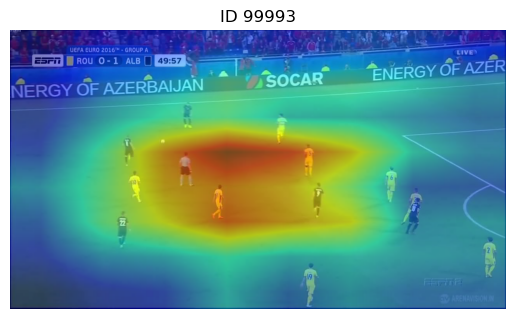

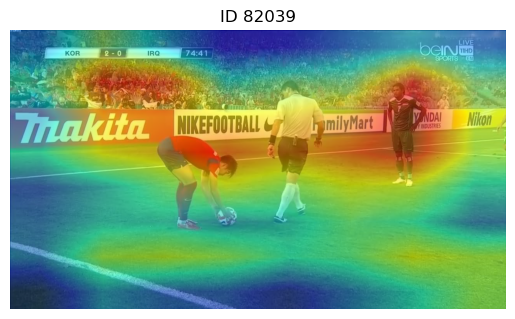

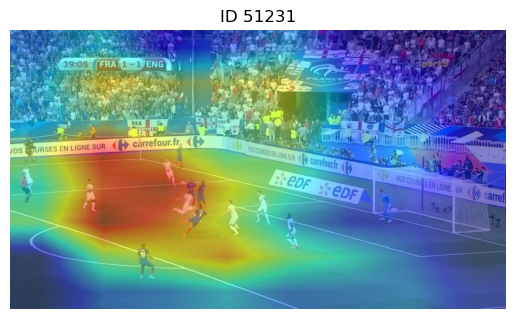

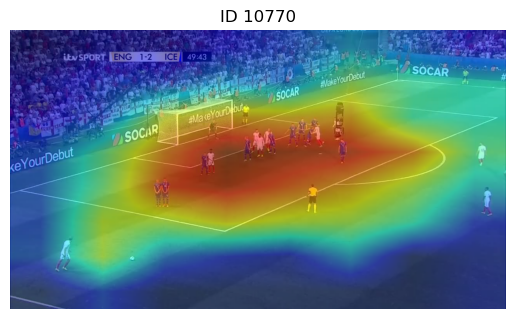

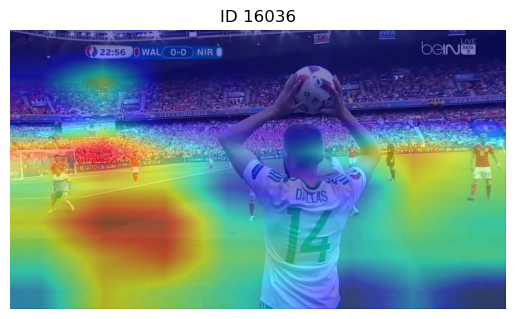

...

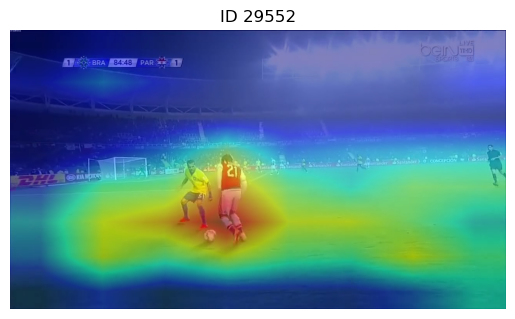

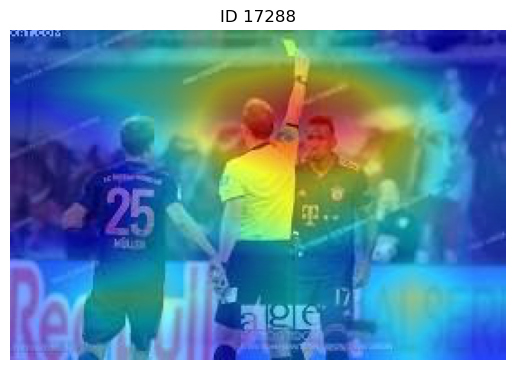

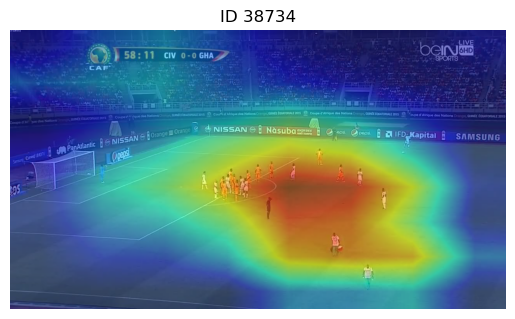

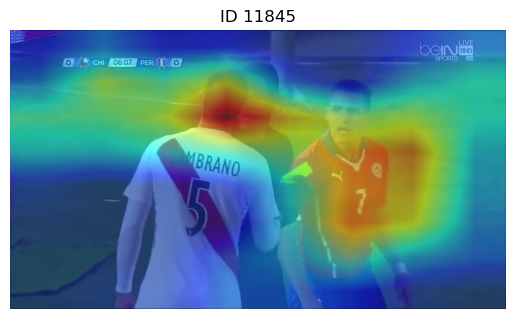

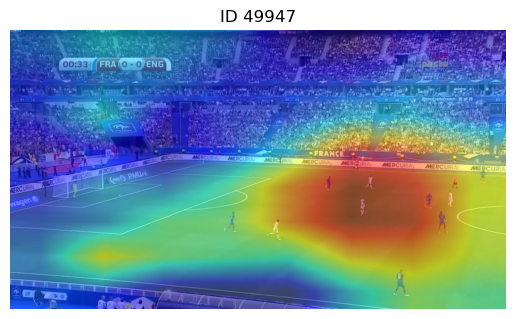

In [45]:
manual_scores = []

for i, row in df_val_eval.iterrows():
    img_id = row['img_id']
    display_cam_overlay(img_id, ref_model1)

    while True:
        try:
            score = int(input("Score CAM (0 = bad, 1 = partial, 2 = good): "))
            if score in [0, 1, 2]:
                break
        except:
            pass
    manual_scores.append(score)

In [46]:
df_val_eval['manual_score'] = manual_scores

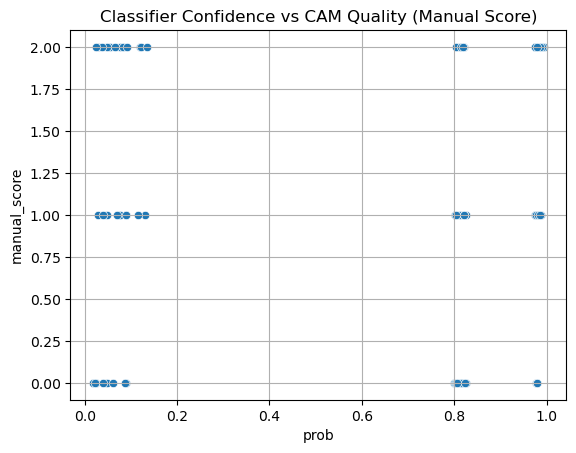

Pearson r: 0.105
Spearman rho: 0.236


In [47]:
from scipy.stats import pearsonr, spearmanr
import seaborn as sns

# Plot
sns.scatterplot(data=df_val_eval, x='prob', y='manual_score')
plt.title("Classifier Confidence vs CAM Quality (Manual Score)")
plt.grid(True)
plt.show()

# Correlation coefficients
pearson, _ = pearsonr(df_val_eval['prob'], df_val_eval['manual_score'])
spearman, _ = spearmanr(df_val_eval['prob'], df_val_eval['manual_score'])
print(f"Pearson r: {pearson:.3f}")
print(f"Spearman rho: {spearman:.3f}")

since 1 means --> not in the hot-spot, but would be included in the mask with higher threshold.
- retain 2 and 0: the really good and the terrible ones

use scores 2 and 0 to evaluate correlation (to filter bad cams) and 1 to adjust the threshold to retain as many masks including the referee as possible

In [53]:
data2 = df_val_eval[df_val_eval['manual_score'].isin([0,2])]
data2[data2['manual_score']==2]

,img_id,prob,manual_score
0,99993,0.805506,2
5,68464,0.120433,2
9,78612,0.812199,2
10,47252,0.984591,2
11,88545,0.803110,2
13,17327,0.989772,2
14,57038,0.055268,2
16,72144,0.076828,2
18,13206,0.819199,2
20,47668,0.979639,2


In [75]:
len(df_val_eval)

90

In [55]:
print(f"out of {len(data2[data2['manual_score']==2])} img with label 2:")
print(f"there are {len(data2[(data2['manual_score']==2)&(data2['prob']>0.8)])} with high confidence")
print()
print()
print(f"out of {len(data2[data2['manual_score']==0])} img with label 0:")
print(f"there are {len(data2[(data2['manual_score']==0)&(data2['prob']>0.8)])} with high confidence")

out of 39 img with label 2:
there are 27 with high confidence


out of 23 img with label 0:
there are 14 with high confidence


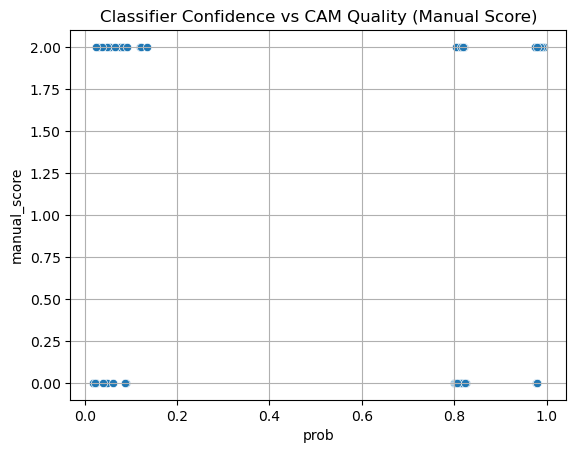

Pearson r: 0.121
Spearman rho: 0.281


In [49]:
# Plot
sns.scatterplot(data=data2, x='prob', y='manual_score')
plt.title("Classifier Confidence vs CAM Quality (Manual Score)")
plt.grid(True)
plt.show()

# Correlation coefficients
pearson, _ = pearsonr(data2['prob'], data2['manual_score'])
spearman, _ = spearmanr(data2['prob'], data2['manual_score'])
print(f"Pearson r: {pearson:.3f}")
print(f"Spearman rho: {spearman:.3f}")

In [76]:
print(f"frac of very good: {len(df_val_eval[df_val_eval['manual_score']==1])/90}")
print(f"frac of so-so: {len(df_val_eval[df_val_eval['manual_score']==1])/90}")
print(f"frac of very bad: {len(df_val_eval[df_val_eval['manual_score']==0])/90}")

frac of very good: 0.3111111111111111
frac of so-so: 0.3111111111111111
frac of very bad: 0.25555555555555554


### Train

In [65]:
train_selected_ids= []
for tr_ids, y_tr in zip(train_ids, y_train):
    if y_tr ==1:
        train_selected_ids.append(tr_ids)

In [ ]:
len(train_selected_ids)

2603

In [69]:
try_df = pd.DataFrame({'img_id': train_selected_ids[:50]}
                      )

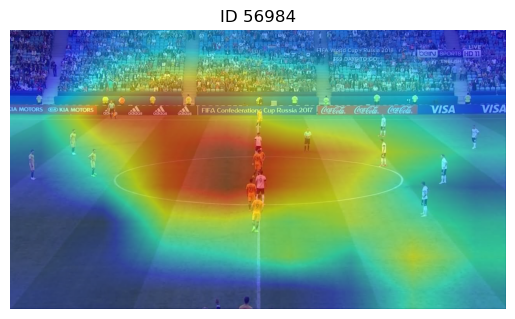

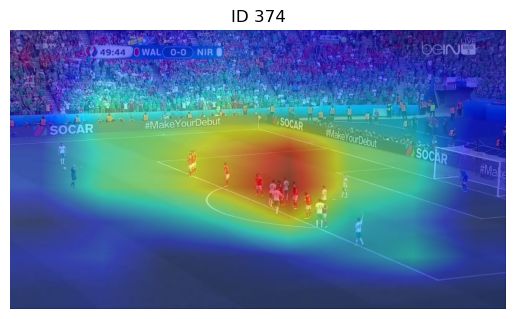

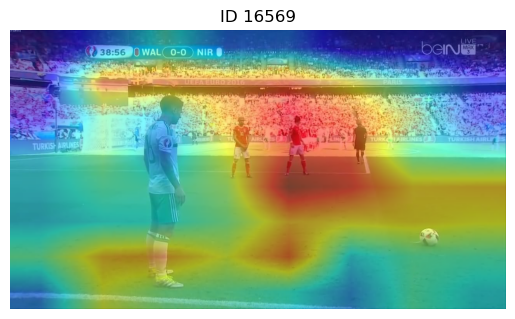

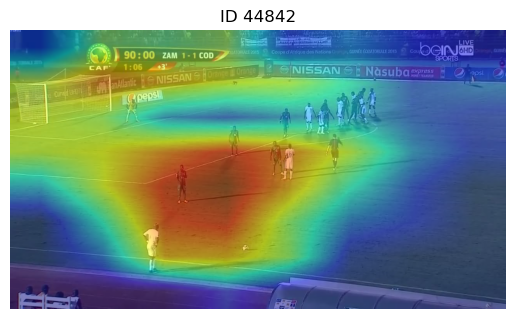

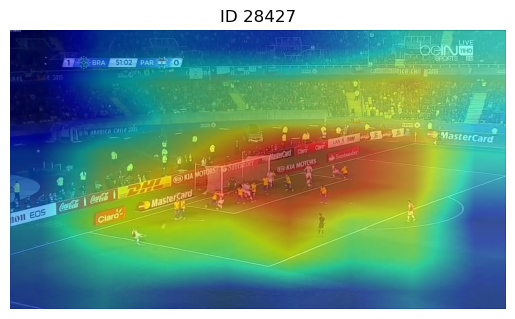

...

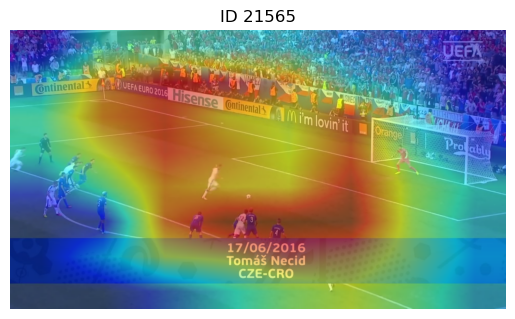

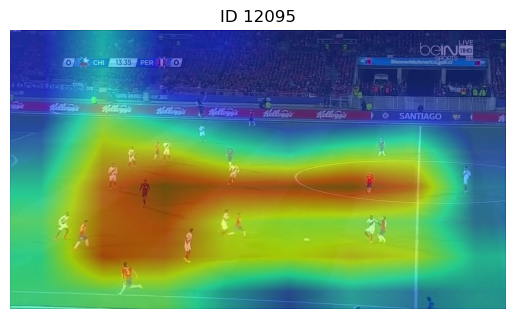

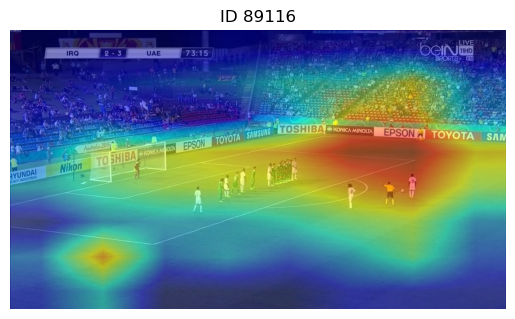

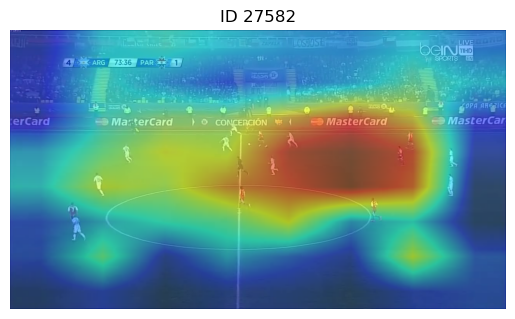

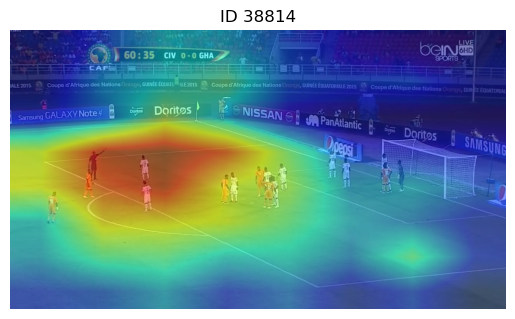

In [70]:
manual_scores = []

for i, row in try_df.iterrows():
    img_id = row['img_id']
    display_cam_overlay(img_id, ref_model1)

    while True:
        try:
            score = int(input("Score CAM (0 = bad, 1 = partial, 2 = good): "))
            if score in [0, 1, 2]:
                break
        except:
            pass
    manual_scores.append(score)

In [71]:
try_df['manual_scores'] = manual_scores

In [74]:
print(f"frac of very good: {len(try_df[try_df['manual_scores']==2])/50}")
print(f"frac of so-so: {len(try_df[try_df['manual_scores']==1])/50}")
print(f"frac of very bad: {len(try_df[try_df['manual_scores']==0])/50}")

frac of very good: 0.36
frac of so-so: 0.34
frac of very bad: 0.3


In conclusion, this category reveals to be noisy as expected.

This is due to difficulty in distinguishing a player from other players, especially without consistency of position in the field, relative position with respect to some reference points, lack of details and colors changing across different matches.

Having relied on an evaluation based on manual annotation, we estimate that around 2000 images will have a middle-high quality, while the 1/3 of the noisy ones are likely to introduce some variability and bias.

To make sure that even the imgs with score 1 contain the referee on their corner, i extend the threshold on cams to 0.6, so that they can filter the image area in a less aggressive way.

# Step 23. From CAM into bounding boxes and masks

#### Bounding Box

We want to threshold the CAM, so convert it into a binary mask:
- 1: region that the model strongly associates with the clue
- 0: irrelevant background

In [78]:
def threshold_cam(cam, threshold=0.6, return_uint8=True):
    """
    Threshold CAM to create a binary mask.
    """
    binary_mask = (cam >= threshold).astype(np.uint8)
    if return_uint8:
        return binary_mask * 255
    return binary_mask


def get_bounding_box_from_mask(mask, min_area=500):
    """
    Extract the largest bounding box from the binary mask.
    Ignores small contours under min_area.
    Returns (x1, y1, x2, y2) or None if nothing found.
    """
    ## Ensure mask is 0/255 (OpenCV expects that)
    #if mask.max() <= 1:
    #    mask = (mask * 255).astype(np.uint8)
    
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours:
        return None

    # Filter out small contours
    large_contours = [c for c in contours if cv2.contourArea(c) > min_area]
    if not large_contours:
        return None

    largest = max(large_contours, key=cv2.contourArea)
    x, y, w, h = cv2.boundingRect(largest)
    return (x, y, x + w, y + h)



def draw_bounding_box(image, bbox, color=(255, 0, 0), thickness=2):
    """
    Draws a bounding box on the image.
    """
    if bbox is not None:
        x1, y1, x2, y2 = bbox
        image = image.copy()
        cv2.rectangle(image, (x1, y1), (x2, y2), color, thickness)
    return image


def mask_from_bbox(bbox, shape):
    """
    Returns a binary mask (0 or 1) of the same shape as the image,
    with the bounding box area set to 1.
    shape: (H, W)
    """
    mask = np.zeros(shape, dtype=np.uint8)
    if bbox is None:
        return mask
    x1, y1, x2, y2 = bbox
    mask[y1:y2, x1:x2] = 1
    return mask


In [79]:
train_selected_ids[:5]

['56984', '374', '16569', '44842', '28427']

Visualize Binary Mask:

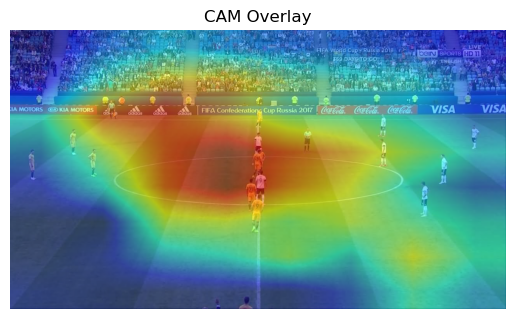

In [80]:
cam_resized, img_pre, cam_resized_original, img_orig = generate_cam(ref_model1,
                                                                    img_id=56984,
                                                                    req_dim=target_dim,
                                                                    return_original=True)
overlay_cam_on_image(image_array = img_orig, cam=cam_resized_original)

In [81]:
mask_bin = threshold_cam(cam_resized_original, threshold=0.6)

Bounding Box:

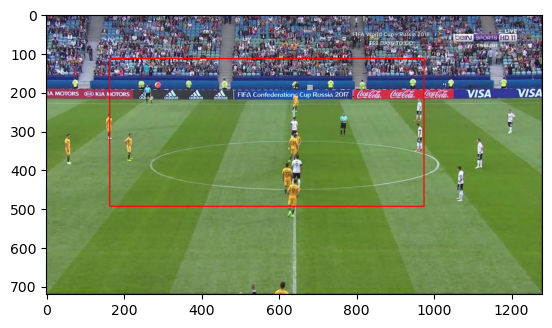

In [82]:
bbox = get_bounding_box_from_mask(mask_bin)
bounding_box = draw_bounding_box(image= img_orig, bbox=bbox)

plt.imshow(bounding_box.astype(np.uint8))

## Mask

In [ ]:
print(f"cam shape: {cam_resized_original.shape}")
print(f"bbox: {bbox}")
print(f"bounding_box: {bounding_box.shape}")

cam shape: (720, 1280)
bbox: (796, 397, 1143, 598)
bounding_box: (720, 1280, 3)


In [83]:
#box_mask = mask_from_bbox(cam_resized_original.shape, bbox)
box_mask = mask_from_bbox(bbox, cam_resized_original.shape)

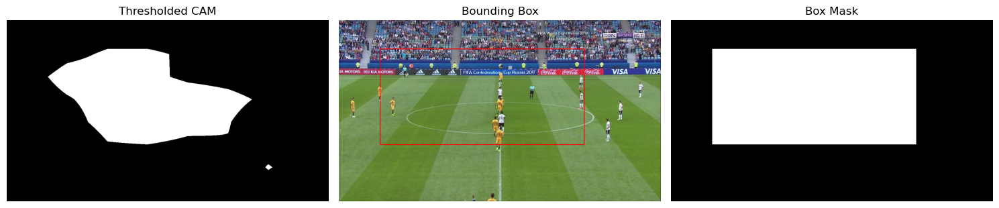

In [84]:
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].imshow(mask_bin, cmap='gray')
axs[0].set_title("Thresholded CAM")
axs[0].axis("off")

axs[1].imshow(bounding_box.astype(np.uint8))
axs[1].set_title("Bounding Box")
axs[1].axis("off")

axs[2].imshow(box_mask, cmap='gray')
axs[2].set_title("Box Mask")
axs[2].axis("off")

plt.tight_layout()
plt.show()

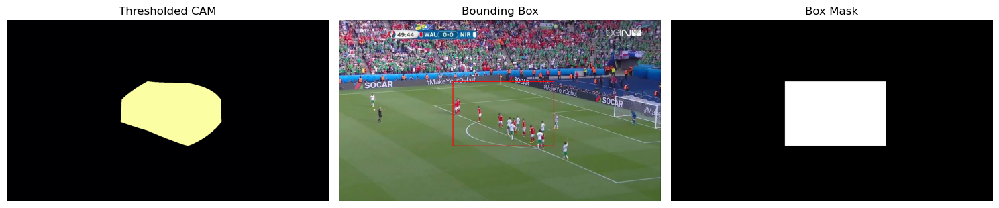

In [86]:
cam_resized, img_pre, cam_resized_original, img_orig = generate_cam(ref_model1,
                                                                    img_id=374,
                                                                    req_dim=target_dim,
                                                                    return_original=True)
mask_bin = threshold_cam(cam_resized_original)
bbox = get_bounding_box_from_mask(mask_bin)
bounding_box = draw_bounding_box(image= img_orig, bbox=bbox)
box_mask = mask_from_bbox(bbox, cam_resized_original.shape)

fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].imshow(mask_bin, cmap='inferno')
axs[0].set_title("Thresholded CAM")
axs[0].axis("off")

axs[1].imshow(bounding_box.astype(np.uint8))
axs[1].set_title("Bounding Box")
axs[1].axis("off")

axs[2].imshow(box_mask, cmap='gray')
axs[2].set_title("Box Mask")
axs[2].axis("off")

plt.tight_layout()
plt.show()

Some bad ones taken from the manual annotation:

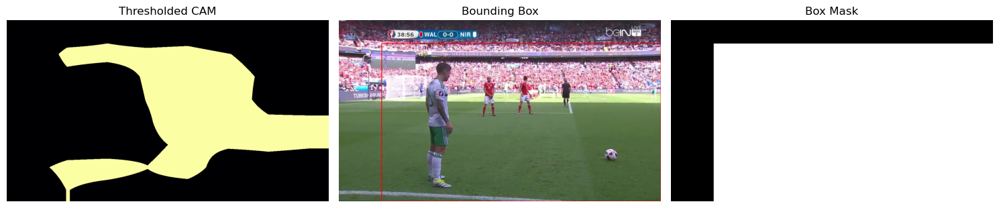

In [87]:
cam_resized, img_pre, cam_resized_original, img_orig = generate_cam(ref_model1,
                                                                    img_id=16569,
                                                                    req_dim=target_dim,
                                                                    return_original=True)
mask_bin = threshold_cam(cam_resized_original)
bbox = get_bounding_box_from_mask(mask_bin)
bounding_box = draw_bounding_box(image= img_orig, bbox=bbox)
box_mask = mask_from_bbox(bbox, cam_resized_original.shape)

fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].imshow(mask_bin, cmap='inferno')
axs[0].set_title("Thresholded CAM")
axs[0].axis("off")

axs[1].imshow(bounding_box.astype(np.uint8))
axs[1].set_title("Bounding Box")
axs[1].axis("off")

axs[2].imshow(box_mask, cmap='gray')
axs[2].set_title("Box Mask")
axs[2].axis("off")

plt.tight_layout()
plt.show()

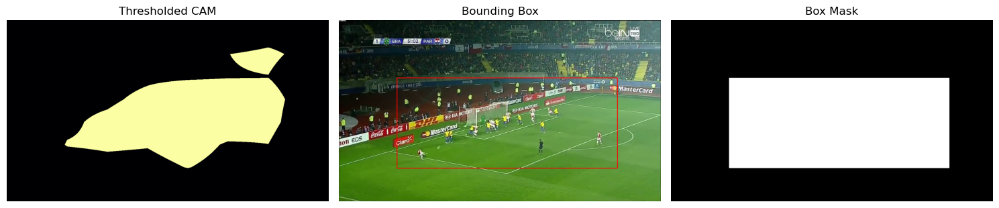

In [88]:
cam_resized, img_pre, cam_resized_original, img_orig = generate_cam(ref_model1,
                                                                    img_id=28427,
                                                                    req_dim=target_dim,
                                                                    return_original=True)
mask_bin = threshold_cam(cam_resized_original)
bbox = get_bounding_box_from_mask(mask_bin)
bounding_box = draw_bounding_box(image= img_orig, bbox=bbox)
box_mask = mask_from_bbox(bbox, cam_resized_original.shape)

fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].imshow(mask_bin, cmap='inferno')
axs[0].set_title("Thresholded CAM")
axs[0].axis("off")

axs[1].imshow(bounding_box.astype(np.uint8))
axs[1].set_title("Bounding Box")
axs[1].axis("off")

axs[2].imshow(box_mask, cmap='gray')
axs[2].set_title("Box Mask")
axs[2].axis("off")

plt.tight_layout()
plt.show()

# EXPORT MASKS

In [ ]:
y_probs.shape

(2000, 1)

In [90]:
selected = clues_df[clues_df['Referee']==1].index.tolist()
len(selected)

3254

In [91]:
output_folder = 'Ref_Mask'
os.makedirs(output_folder, exist_ok=True)

In [92]:
def export_mask_for_image(img_id, model, output_dir, threshold=0.6, min_area=500):
    try:
        # Generate CAM
        __, __, cam_orig, img_orig = generate_cam(model, img_id, return_original=True)

        # Threshold CAM
        mask_bin = threshold_cam(cam_orig, threshold=threshold)

        # Extract bounding box
        bbox = get_bounding_box_from_mask(mask_bin, min_area=min_area)

        # Step 4: Create binary mask from box
        box_mask = mask_from_bbox(bbox, cam_orig.shape)  # shape = (H, W)

        # Step 5: Save as .png
        output_path = os.path.join(output_dir, f"{img_id}_mask.jpg")
        cv2.imwrite(output_path, box_mask * 255)  # ensure it's in [0, 255] for binary image

        return True
    except Exception as e:
        print(f"Failed to process img_id {img_id}: {e}")
        return False

In [93]:
from tqdm import tqdm

In [94]:
success_count = 0
for img_id in tqdm(selected, desc="Exporting masks"):
    if export_mask_for_image(img_id, ref_model1, output_folder):
        success_count += 1

Exporting masks: 100%|██████████| 3254/3254 [13:03<00:00,  4.15it/s]
